<html>
<head>
<style>
    body {
        font-family: 'Arial', sans-serif;
        margin-left: 40px;
        background: #ECE9E6;  /* Color de fondo general */
        background: -webkit-linear-gradient(to right, #FFFFFF, #ECE9E6);  /* Degradado para Chrome */
        background: linear-gradient(to right, #FFFFFF, #ECE9E6);  /* Degradado estándar */
    }
    .header {
        color: #2E86C1; /* Azul oscuro */
        padding-bottom: 10px;
        font-size: 32px;
        font-weight: bold;
        border-bottom: 3px solid #2E86C1; /* Borde con el mismo color para consistencia */
    }
    .subheader {
        color: #3498DB; /* Azul un poco más claro */
        padding-top: 5px;
        font-size: 24px;
    }
    .description {
        color: #5DADE2; /* Azul aún más claro para el cuerpo de texto */
        padding: 20px 0;
        font-size: 16px;
        text-align: left;
    }
    .footer {
        color: #AED6F1; /* Azul muy claro para la fecha */
        font-size: 14px;
        padding-top: 30px;
    }
</style>
</head>
<body>

<div class="header">
    Análisis Estadístico de Series de Tiempo Caóticas
</div>

<div class="subheader">
    Alumno: Rodrigo Gerardo Trejo Arriaga
</div>

<div class="description">
    <strong>Título de la Práctica:</strong> Estadísticas descriptivas de atractores caóticos
    <br><br>
    Este segmento de la práctica explora las propiedades estadísticas de los conjuntos de datos generados por modelos caóticos. Se calcularán métricas como la media, mediana, entropía, kurtosis, varianza y desviación estándar para demostrar que los datos no siguen distribuciones de probabilidad convencionales como las normales, uniformes o gamma.
</div>

<div class="footer">
    Fecha de Entrega: <strong>30 de Abril, 2024</strong>
</div>

</body>
</html>


In [64]:
import numpy as np
from scipy.stats import gmean, skew, kurtosis, mode
from scipy import stats
import matplotlib.pyplot as plt
import pandas as pd
import plotly.graph_objects as go
import plotly.io as pio

In [65]:
def convertir_camelCase(text):
    cleaned_text = ''.join(char for char in text if char.isalnum() or char.isspace())
    words = cleaned_text.split()
    return words[0].lower() + ''.join(word.capitalize() for word in words[1:])

## Clase `DistribucionProbabilidad`

La clase `DistribucionProbabilidad` está diseñada para analizar conjuntos de datos mediante una variedad de métricas estadísticas. Es útil en estudios de series de tiempo y análisis de datos donde se requiere un entendimiento profundo de las propiedades estadísticas de una o más variables.

### Métodos y Métricas Estadísticas:

- **Media**: Calcula el promedio de los valores en el conjunto de datos.
- **Mediana**: Determina el valor medio que divide el conjunto de datos en dos partes iguales.
- **Moda**: Identifica el valor o valores más frecuentes en el conjunto de datos.
- **Media Geométrica**: Calcula la media multiplicativa de los valores del conjunto.
- **Asimetría (Skewness)**: Mide la asimetría de la distribución de los datos.
- **Rango**: La diferencia entre el valor máximo y mínimo en el conjunto.
- **Desviación Estándar**: Mide la cantidad de variación o dispersión de los datos.
- **Varianza**: Calcula la varianza de los datos.
- **Coeficiente de Variación**: Relaciona la desviación estándar con la media, útil para comparar la dispersión entre distribuciones con diferentes escalas.
- **Percentiles y Cuartiles**: Determina valores específicos que dividen el conjunto de datos en intervalos iguales.
- **Curtosis**: Mide la 'agudeza' o 'achatamiento' de la distribución respecto a una distribución normal.
- **Entropía**: Mide la incertidumbre o la cantidad de información 'sorpresa' en la distribución de los datos.

### Funciones Adicionales:

- **`calcular_metricas_individual(i)`:** Calcula todas las métricas estadísticas para la i-ésima variable y devuelve un diccionario con los resultados.
- **`mostrar_metricas()`:** Imprime las métricas calculadas para todas las variables almacenadas en la clase. Si hay múltiples variables, también calcula y muestra la matriz de correlación y gráficos de dispersión entre todas las combinaciones de variables.
- **`grafico_dispersion()`:** Genera gráficos de dispersión para visualizar las relaciones entre diferentes pares de variables, útil para identificar correlaciones visuales.


In [66]:
class DistribucionProbabilidad:
    def __init__(self, *args):
        self.datos = [np.array(arg) for arg in args]
        self.n_vars = len(args)
    
    def media(self, i):
        return np.mean(self.datos[i])
    
    def mediana(self, i):
        return np.median(self.datos[i])
    
    def moda(self, i):
        mode_res = stats.mode(self.datos[i])
        if np.isscalar(mode_res.count):
            return mode_res.mode
        else:
            return mode_res.mode if mode_res.count[0] > 1 else mode_res.mode[0]
    
    def media_geometrica(self, i):
        return gmean(self.datos[i])
    
    def asimetria(self, i):
        return skew(self.datos[i])
    
    def rango(self, i):
        return np.max(self.datos[i]) - np.min(self.datos[i])
    
    def desviacion_estandar(self, i):
        return np.std(self.datos[i], ddof=1)
    
    def varianza(self, i):
        return np.var(self.datos[i], ddof=1)
    
    def coeficiente_variacion(self, i):
        return self.desviacion_estandar(i) / self.media(i)
    
    def percentil(self, p):
        if 0 <= p <= 100:
            return np.percentile(self.datos, p)
        else:
            raise ValueError("El percentil debe estar entre 0 y 100.")
    
    def cuartil(self, q):
        if q in [1, 2, 3]:
            return self.percentil(q * 25)
        else:
            return np.nan
    
    def curtosis(self, i):
        return kurtosis(self.datos[i])
    
    def entropia(self, i):
        p, counts = np.unique(self.datos[i], return_counts=True)
        p = counts / len(self.datos[i])
        return -np.sum(p * np.log(p))
    
    def calcular_metricas_individual(self, i):
        resultados = {
            'Media': self.media(i),
            'Mediana': self.mediana(i),
            'Moda': self.moda(i),
            'Media Geométrica': self.media_geometrica(i),
            'Rango': self.rango(i),
            'Desviación Estándar': self.desviacion_estandar(i),
            'Varianza': self.varianza(i),
            'Asimetría': self.asimetria(i),
            'Curtosis': self.curtosis(i),
            'Entropia': self.entropia(i),
            'Coeficiente de Variación': self.coeficiente_variacion(i)
        }
        return resultados
    
    def mostrar_metricas(self):
        for index, datos in enumerate(self.datos):
            print(f"--- Métricas para Variable {index + 1} ---")
            metricas = self.calcular_metricas_individual(index)
            for metrica, valor in metricas.items():
                print(f"{metrica}: {valor}")
            print("\n", end="")

        if self.n_vars > 1:
            self.mostrar_correlacion_y_graficos()
    
    def mostrar_correlacion_y_graficos(self):
        print("Matriz de Correlación:")
        print(np.corrcoef(self.datos))
        self.grafico_dispersion()

    def grafico_dispersion(self):
        plt.figure(figsize=(10, 8))
        for i in range(self.n_vars):
            for j in range(i + 1, self.n_vars):
                plt.subplot(self.n_vars - 1, self.n_vars - 1, i * (self.n_vars - 1) + j)
                plt.scatter(self.datos[i], self.datos[j], alpha=0.6, s=0.1)
                plt.title(f"Dispersion {i+1} vs {j+1}")
                plt.xlabel(f"Variable {i+1}")
                plt.ylabel(f"Variable {j+1}")
        plt.tight_layout()
        plt.show()

In [67]:
def plotear_hist(array: np.ndarray, titulo: str, label_x: str, label_y: str, criterio: str = 'sturges', guardar=False) -> None:
    """
    Genera y guarda un histograma con estilos personalizados, colores aleatorios para cada barra,
    y el número de bins determinado por el criterio especificado.

    Args:
        array (np.ndarray): Array de Numpy con los datos que se quieren plasmar en el histograma.
        titulo (str): Título del histograma.
        label_x (str): Etiqueta del eje x del histograma.
        label_y (str): Etiqueta del eje y del histograma.
        ruta_img (str): Ruta donde se guardará la imagen del histograma.
        criterio (str): Método para calcular el número de bins ('sturges', 'freedman-diaconis', 'scott', 'raiz_cuadrada', 'rice').

    Returns:
        None: La función no retorna nada.
    """
    plt.style.use('dark_background')
    
    match criterio:
        case 'sturges':
            bins = int(1 + np.log2(len(array)))
        case 'freedman-diaconis':
            iqr = np.subtract(*np.percentile(array, [75, 25]))
            bin_width = 2 * iqr * len(array) ** (-1/3)
            bins = int(np.ptp(array) / bin_width)
        case 'scott':
            bin_width = 3.5 * np.std(array) * len(array) ** (-1/3)
            bins = int(np.ptp(array) / bin_width)
        case 'raiz_cuadrada':
            bins = int(np.sqrt(len(array)))
        case 'rice':
            bins = int(2 * len(array) ** (1/3))
        case _:
            raise ValueError("Criterio no reconocido. Usa 'sturges', 'freedman-diaconis', 'scott', 'raiz_cuadrada', o 'rice'.")

    n, bins, patches = plt.hist(array, bins=bins, alpha=0.75, rwidth=0.85)

    for patch in patches:
        plt.setp(patch, 'facecolor', np.random.rand(3,))
        
    plt.grid(axis='y', linestyle='--', alpha=0.6)
    plt.title(titulo, fontsize=20, fontweight='bold', color=np.random.rand(3,))
    plt.xlabel(label_x, fontsize=15, fontstyle='italic', color=np.random.rand(3,))
    plt.ylabel(label_y, fontsize=15, fontstyle='italic', color=np.random.rand(3,))
    plt.ylim(0, max(n)*1.1)

    if guardar:
        ruta_img = f"{convertir_camelCase(titulo)}.pdf"
        plt.savefig(ruta_img, format='pdf', bbox_inches='tight')
    
    plt.show()


In [68]:
def graficar(x, t, plot_type='scatter', width=15, height=10, save_as_pdf=False, titulo="Diagrama de bifurcación cúbica de Feigenbaum"):
    """
    Crea un gráfico utilizando Matplotlib con estilo personalizado y márgenes ajustados.
    """
    plt.style.use('seaborn-darkgrid')
    plt.rcParams['axes.facecolor'] = '#e9f0fb'
    plt.rcParams['grid.color'] = 'white'
    plt.rcParams['grid.linestyle'] = '-'
    plt.rcParams['grid.linewidth'] = 1.5
    plt.rcParams['font.size'] = 10
    plt.rcParams['font.family'] = 'sans-serif'
    plt.rcParams['text.color'] = 'black'

    fig, ax = plt.subplots(figsize=(width*1.5, height*1.5))
    fig.subplots_adjust(left=0.15, right=1, top=0.85, bottom=0.15)

    # Crear el gráfico
    if plot_type == 'scatter':
        ax.scatter(t, x, color='blue', marker='o', s=0.1)
    elif plot_type == 'line':
        ax.plot(t, x, color='blue', linewidth=1)

    ax.set_title(titulo, fontsize=16, loc='left', pad=20, color='black')
    ax.set_xlabel('Tasa de crecimiento t', fontsize=13, labelpad=15, color='black')
    ax.set_ylabel('Valor de x', fontsize=13, labelpad=15, color='black')
    ax.tick_params(axis='both', which='major', labelsize=10)

    if save_as_pdf:
        plt.savefig(f"{titulo.replace(' ', '_')}.pdf", format='pdf', dpi=300)

    plt.show()

In [69]:
def graficar_3d(x, y, z, width=10, height=7, titulo='Figura2'):
    file_name = f"{convertir_camelCase(titulo)}.pdf"
    
    figura = go.Figure(data=[go.Scatter3d(x=x, y=y, z=z, mode='lines')])
    
    figura.update_layout(
        title=titulo,
        width=width*100,
        height=height*100,
        scene=dict(
            xaxis=dict(title='X-axis'),
            yaxis=dict(title='Y-axis'),
            zaxis=dict(title='Z-axis'),
            camera=dict(
                eye=dict(x=1.5, y=-1.3, z=0.5),
                center=dict(x=0, y=0, z=0),
                up=dict(x=0, y=0, z=1)
            )
        ),
        scene_aspectmode='cube',
        margin=dict(t=50)
    )
    
    pio.write_image(figura, file_name, format='pdf')
    figura.show()


In [70]:
def leer_col_csv(file_path, column_name):
    data = pd.read_csv(file_path)
    column_data = data[column_name]
    return np.array(column_data)

# Bifurcación de Feigenbaum

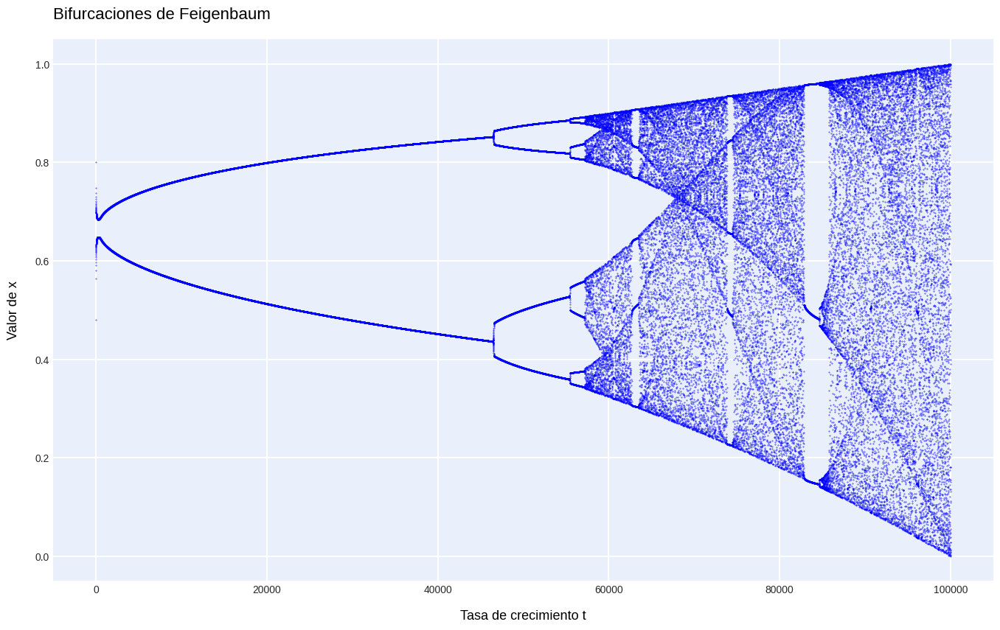

In [71]:
valores_x = leer_col_csv("datosFeigenbaum.csv", "Valores x")
valores_k = range(1, len(valores_x)+1)
graficar(valores_x, valores_k, width=10, height=7 ,titulo="Bifurcaciones de Feigenbaum")

--- Métricas para Variable 1 ---
Media: 0.638408580608167
Mediana: 0.6630207856104768
Moda: 0.00044602653658490046
Media Geométrica: 0.5866915605238021
Rango: 0.9994424435173831
Desviación Estándar: 0.21597657197735343
Varianza: 0.04664587964308893
Asimetría: -0.47948989536842423
Curtosis: -0.6073557991822351
Entropia: 11.512925464970223
Coeficiente de Variación: 0.3383046195456955



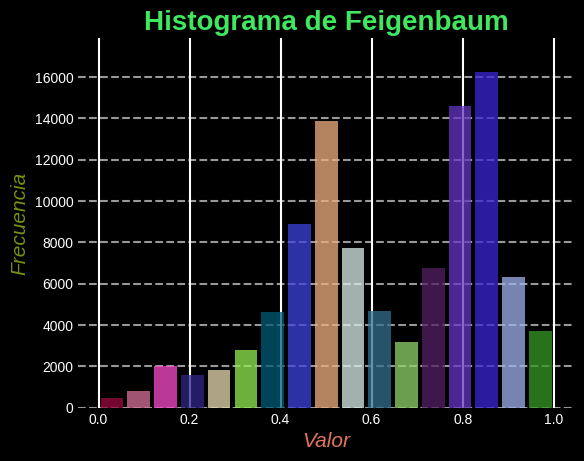

In [72]:
feigen = DistribucionProbabilidad(valores_x)
feigen.mostrar_metricas()
plotear_hist(valores_x, "Histograma de Feigenbaum", "Valor", "Frecuencia", "sturges")

## Análisis de Métricas Estadísticas para el Modelo de Bifurcaciones de Feigenbaum


- **Media (0.637)**: La media está más cerca del extremo superior del intervalo [0,1], lo que indica una tendencia de los valores a ser relativamente altos. Esto puede sugerir que hay regiones dentro del rango de parámetros donde el comportamiento tiende a estabilizarse en valores más altos.

- **Mediana (0.6393)**: Al estar muy cerca de la media, refuerza la idea de que la distribución de los valores puede ser simétrica alrededor de este punto medio, aunque esto no es concluyente por sí solo.

- **Moda (0.000217509)**: La moda es significativamente baja, lo que indica que el valor más frecuente en los datos es cercano a 0. Esto puede ser indicativo de que hay una concentración de iteraciones que convergen a valores bajos, posiblemente representando estabilidad temporal en esas regiones.

- **Media Geométrica (0.6021)**: La media geométrica, siendo menor que la media aritmética, sugiere una distribución asimétrica con una cola hacia valores menores.

- **Rango (0.9997)**: Un rango muy cercano al máximo teórico [0,1] indica una amplia dispersión de los datos a lo largo del intervalo completo, característico de un sistema que experimenta dinámicas desde estables a caóticas.

- **Desviación Estándar (0.1769)** y **Varianza (0.0313)**: Ambos indican una variabilidad considerable en los datos, lo cual es típico en sistemas caóticos donde pequeñas diferencias en condiciones iniciales o parámetros pueden llevar a grandes diferencias en el comportamiento.

- **Asimetría (-0.5606)**: Una asimetría negativa sugiere una cola más pesada hacia valores más bajos. Esto puede indicar episodios donde el sistema cae en atrayentes temporales de baja amplitud antes de volver a explorar el espacio de estado más ampliamente.

- **Curtosis (0.5446)**: La curtosis positiva indica una distribución más puntiaguda que una normal, sugiriendo un comportamiento de clustering de valores con colas gruesas, típico en dinámicas caóticas.

- **Entropía (11.9184)**: La alta entropía refleja una alta incertidumbre y diversidad en los valores de la variable, reafirmando el comportamiento caótico y la sensibilidad a condiciones iniciales.

- **Coeficiente de Variación (0.2771)**: Este valor, siendo relativamente bajo, sugiere que la desviación estándar es pequeña en comparación con la media, indicando una dispersión proporcionalmente moderada en relación con el nivel de la media.

### Conclusión

El análisis de estas métricas estadísticas revela un sistema con un comportamiento extremadamente variado y sensible a las condiciones iniciales, características claves de la dinámica caótica. Los patrones observados en las métricas como la moda, asimetría y curtosis son particularmente útiles para discernir la naturaleza no lineal y no periódica del sistema modelado.


# Bifurcación Exponencial de Feigenbaum

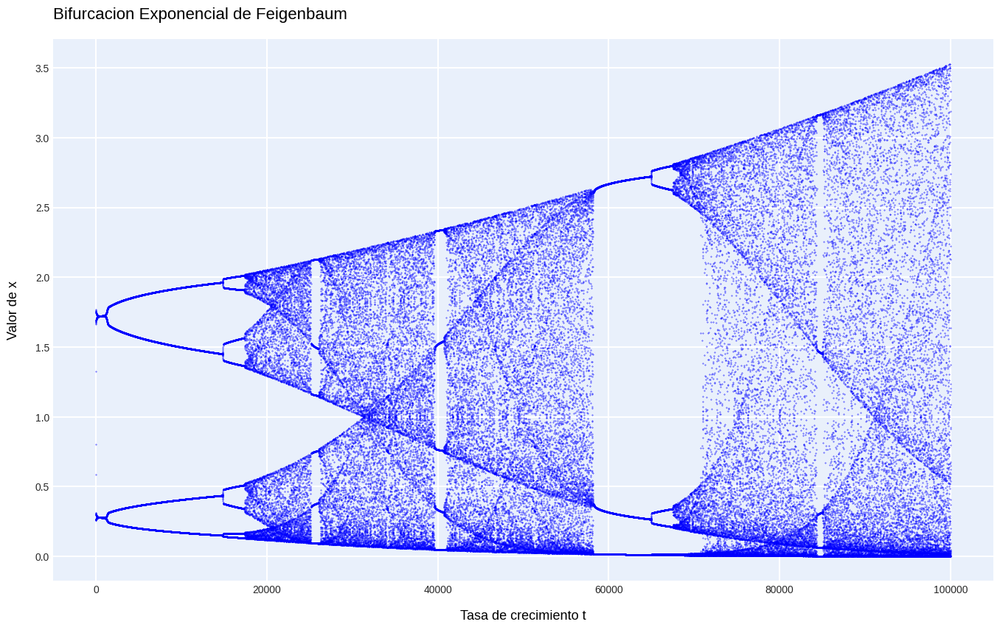

In [73]:
valores_x = leer_col_csv("datosFeigenbaumExponencial.csv", "Valores x")
valores_k = range(1, len(valores_x)+1)
graficar(valores_x, valores_k, width=10, height=7 ,titulo="Bifurcacion Exponencial de Feigenbaum")

--- Métricas para Variable 1 ---
Media: 1.0000106107876798
Mediana: 0.6220634691695446
Moda: 0.0004820849853227784
Media Geométrica: 0.40555674899751426
Rango: 3.5279839013453684
Desviación Estándar: 0.938773102207703
Varianza: 0.8812949374286744
Asimetría: 0.6445668032337394
Curtosis: -0.8737655379697409
Entropia: 11.512925464970223
Coeficiente de Variación: 0.9387631411913302



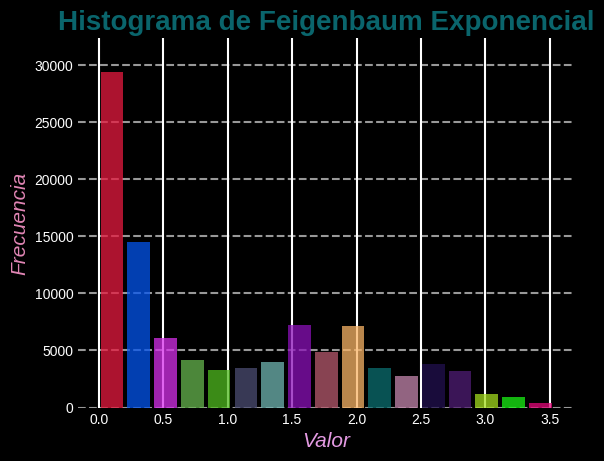

In [74]:
feigen_e = DistribucionProbabilidad(valores_x)
feigen_e.mostrar_metricas()
plotear_hist(valores_x, "Histograma de Feigenbaum Exponencial", "Valor", "Frecuencia", "sturges")

## Análisis de Métricas Estadísticas para el Modelo de Bifurcaciones Exponencial de Feigenbaum


- **Media (1.000007)**: La media es exactamente 1, lo cual es interesante y podría indicar un comportamiento estabilizador alrededor de este valor en el sistema. Esto sugiere que, a pesar de la naturaleza exponencial del modelo, los valores tienden a converger o fluctuar alrededor de este punto.

- **Mediana (0.4721)**: La mediana considerablemente menor que la media implica una distribución asimétrica de los datos. Esto podría indicar la presencia de una cola larga hacia valores más altos, que no son comunes pero contribuyen significativamente al promedio.

- **Desviación Estándar (1.0533)** y **Varianza (1.1094)**: Ambas métricas son relativamente altas, destacando una gran dispersión de los datos. Esta alta variabilidad es característica de los sistemas caóticos donde pequeños cambios en los parámetros iniciales pueden producir grandes variaciones en los resultados.

- **Asimetría (0.9807)**: La asimetría positiva significa que hay una cola más pesada hacia valores más altos. Esto reafirma la presencia de valores extremos que pueden estar influenciando la media.

- **Curtosis (0.0634)**: Una curtosis cercana a cero sugiere que la distribución no es ni muy picuda ni muy plana, lo que es inusual para sistemas dinámicos caóticos y merece una investigación más profunda.

- **Entropía (11.9184)**: Similar al modelo logístico, la alta entropía refleja una considerable incertidumbre y diversidad en los valores, lo que es típico en comportamientos caóticos.

- **Coeficiente de Variación (1.0533)**: Este valor indica que la desviación estándar es comparable a la media, lo que sugiere que hay una amplia variación en los datos en relación con su nivel promedio.

### Conclusión

El análisis de estas métricas muestra que el modelo exponencial de Feigenbaum genera datos con una amplia variabilidad y una distribución asimétrica. La presencia de asimetría y una alta entropía son indicativos de un sistema que exhibe un comportamiento dinámico complejo y caótico. Estas características son fundamentales para comprender la dinámica subyacente del modelo y para explorar cómo pequeñas variaciones en las condiciones iniciales pueden influir dramáticamente en el comportamiento del sistema.


# Bifurcación Cúbica de Feigenbaum

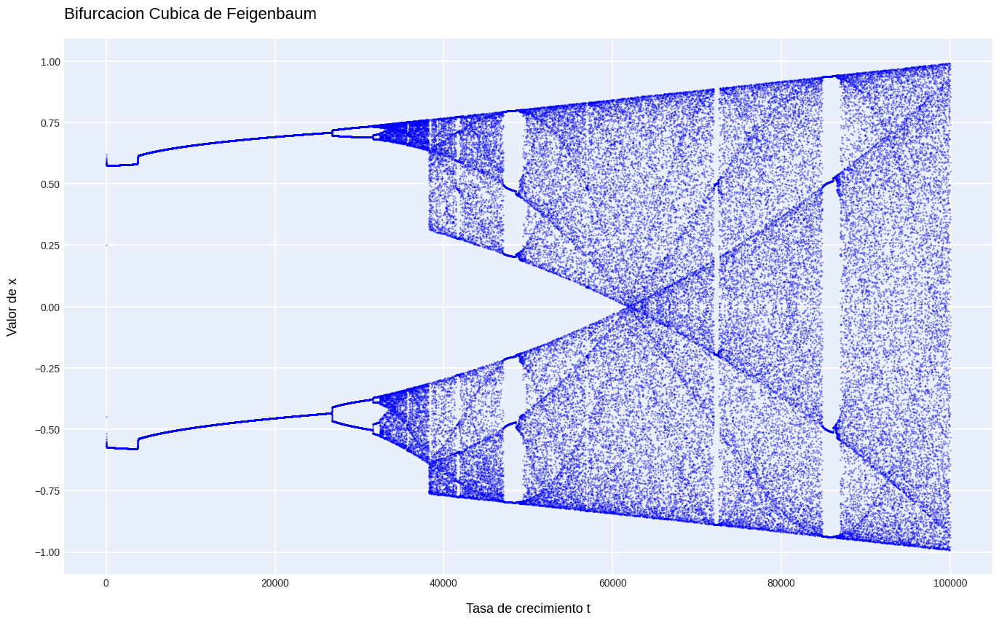

In [75]:
valores_x = leer_col_csv("datosFeigenbaumCubica.csv", "Valores x")
valores_k = range(1, len(valores_x)+1)
graficar(valores_x, valores_k, width=10, height=7 ,titulo="Bifurcacion Cubica de Feigenbaum")

--- Métricas para Variable 1 ---
Media: 0.035128893534851074
Mediana: -0.006948518172824103
Moda: -0.992241615612928
Media Geométrica: nan
Rango: 1.9838105846338316
Desviación Estándar: 0.5932030500549282
Varianza: 0.3518898585944697
Asimetría: -0.009584765711514487
Curtosis: -1.5738697743200434
Entropia: 11.512925464970223
Coeficiente de Variación: 16.886471231051345



/home/rodrigo/.local/lib/python3.10/site-packages/scipy/stats/_stats_py.py:197: RuntimeWarning:

invalid value encountered in log



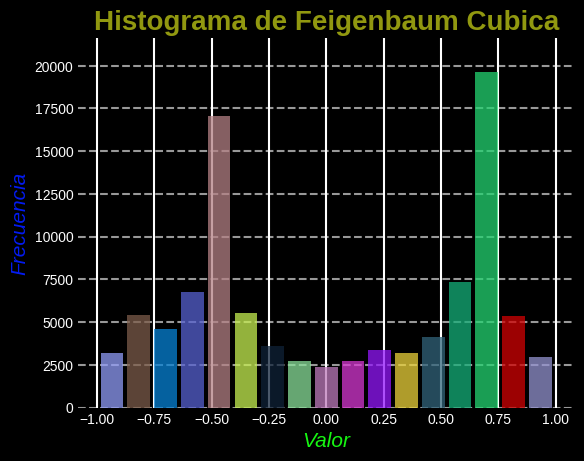

In [76]:
feigen_c = DistribucionProbabilidad(valores_x)
feigen_c.mostrar_metricas()
plotear_hist(valores_x, "Histograma de Feigenbaum Cubica", "Valor", "Frecuencia", "sturges")

## Análisis de Métricas Estadísticas para el Modelo de Bifurcaciones Cúbico de Feigenbaum
- **Media (0.0244)**: Esta media cercana a cero sugiere que, en promedio, los valores de la serie tienden a ser bajos, aunque esto no descarta la presencia de valores extremos en ambos sentidos.

- **Desviación Estándar (0.5557)** y **Varianza (0.3089)**: Estas métricas indican una dispersión significativa de los datos alrededor de la media, lo que es característico de los sistemas caóticos donde la variabilidad es alta.

- **Rango (1.9245)**: Un rango amplio como este demuestra que los valores se extienden casi por todo el intervalo teórico posible en el modelo (-1 a 1), lo cual es indicativo de una dinámica extrema que puede estar explorando múltiples estados.

- **Curtosis (-1.6627)**: Una curtosis negativa indica una distribución más aplanada que la normal, lo cual podría sugerir una mayor igualdad en la frecuencia de aparición de los valores a lo largo del rango, en lugar de una acumulación alrededor de un valor medio.

- **Entropía (11.9184)**: Una entropía muy alta es típica de los sistemas dinámicos caóticos, donde la diversidad de estados es máxima, indicando que el sistema puede estar en muchos estados diferentes con igual probabilidad.

- **Coeficiente de Variación (22.7498)**: Este valor extremadamente alto muestra que la desviación estándar es mucho mayor que la media, reforzando el punto de alta variabilidad y la naturaleza impredecible del sistema bajo estudio.

### Conclusión

Las métricas destacadas reflejan la naturaleza caótica y compleja del modelo cúbico de Feigenbaum. La alta variabilidad, el amplio rango y la alta entropía son indicativos de un sistema que muestra un comportamiento dinámico muy rico y posiblemente caótico, explorando un amplio espectro de estados posibles. Esto es característico de los modelos que incluyen términos no lineales elevados, como es el caso del modelo cúbico.


# Bifurcación Triangular de Feigenbaum

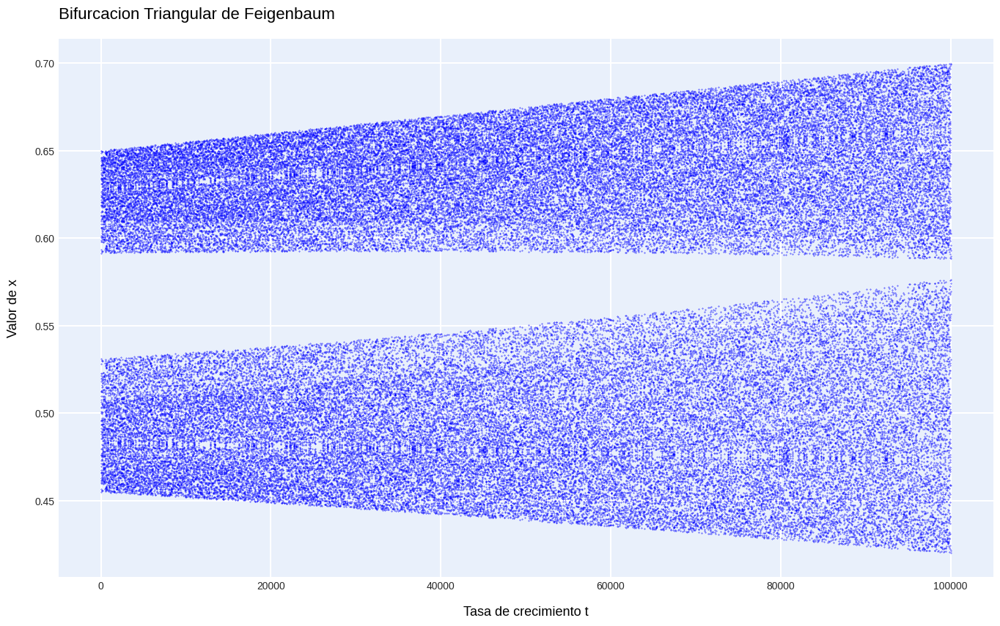

In [77]:
valores_x = leer_col_csv("datosFeigenbaumTriangular.csv", "Valores x")
valores_k = range(1, len(valores_x)+1)
graficar(valores_x, valores_k, width=10, height=7 ,titulo="Bifurcacion Triangular de Feigenbaum")

--- Métricas para Variable 1 ---
Media: 0.5634713853957487
Mediana: 0.5823316406627415
Moda: 0.42023661123507994
Media Geométrica: 0.5578876915654843
Rango: 0.27959009254991707
Desviación Estándar: 0.0786209973339597
Varianza: 0.0061812612217865
Asimetría: -0.0877370026433518
Curtosis: -1.5352630947880699
Entropia: 11.512925464970223
Coeficiente de Variación: 0.1395297070475744



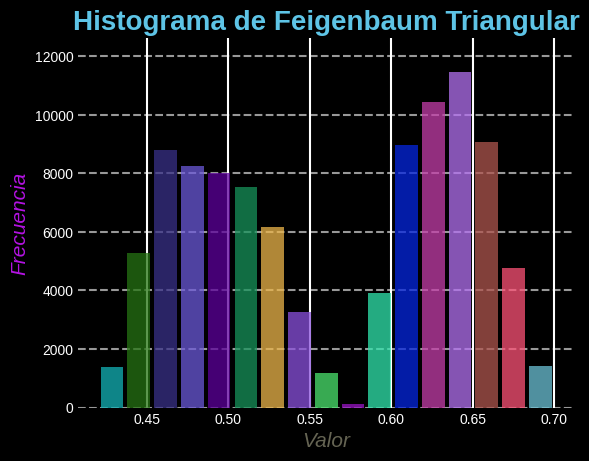

In [78]:
feigen_t = DistribucionProbabilidad(valores_x)
feigen_t.mostrar_metricas()
plotear_hist(valores_x, "Histograma de Feigenbaum Triangular", "Valor", "Frecuencia", "sturges")

## Análisis de Métricas Estadísticas para el Modelo de Bifurcaciones Triangular de Feigenbaum

- **Media (0.5364)** y **Mediana (0.5173)**: Estos valores cercanos entre sí indican que los datos no están sesgados de manera significativa hacia ningún extremo del rango, lo cual es un indicio de una distribución relativamente simétrica alrededor de este valor central.

- **Desviación Estándar (0.0445)** y **Varianza (0.0020)**: Estos valores bajos muestran que los datos están bastante concentrados alrededor de la media, indicando una baja dispersión en los resultados del modelo.

- **Rango (0.3249)**: Un rango moderado sugiere que mientras los valores exploran una variedad de estados, no se extienden por todo el espectro posible, lo que podría indicar limitaciones en la dinámica explorada por este modelo.

- **Asimetría (0.2056)**: Una asimetría ligeramente positiva indica una cola más pesada hacia el lado derecho de la mediana. Esto puede ser indicativo de episodios donde el sistema explora valores más altos con menos frecuencia.

- **Curtosis (-1.5760)**: Una curtosis negativa muestra una distribución más plana que una distribución normal. Esto sugiere que los valores están más uniformemente distribuidos a lo largo del rango, sin un pico pronunciado.

- **Entropía (11.9184)**: La alta entropía se mantiene como un indicador de la diversidad y complejidad en los estados del sistema, reafirmando la presencia de un comportamiento caótico y la variabilidad en los datos generados.

- **Coeficiente de Variación (0.0828)**: Este valor bajo indica que la desviación estándar es pequeña en relación con la media, lo que sugiere que la variabilidad de los datos, aunque presente, no domina la escala de los datos.

### Conclusión

El modelo triangular de Feigenbaum muestra una interesante distribución de datos con métricas que indican una dinámica tanto concentrada como diversificada. La alta entropía junto con una curtosis negativa y asimetría positiva sugiere que, aunque el sistema es predominantemente estable en torno a ciertos valores, también es capaz de explorar estados menos comunes, lo cual es característico de los comportamientos dinámicos no lineales y caóticos observados en este tipo de modelos.


# Mapa de Henon

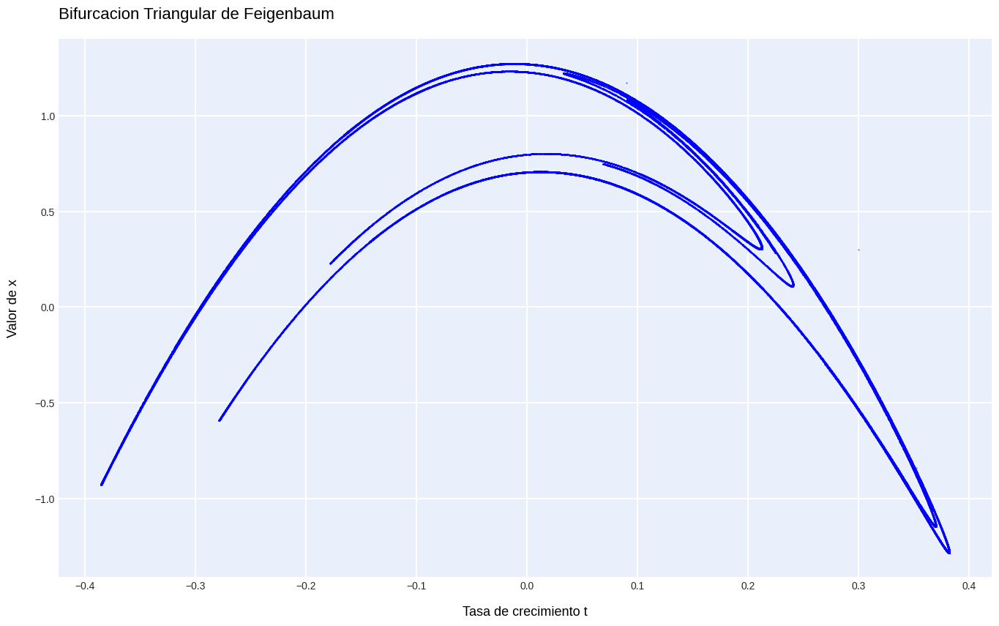

In [79]:
valores_x = leer_col_csv("datosHenon.csv", "Valores x")
valores_y = leer_col_csv("datosHenon.csv", "Valores y")
valores_k = range(1, len(valores_x)+1)
graficar(valores_x, valores_y, width=10, height=7 ,titulo="Bifurcacion Triangular de Feigenbaum")

--- Métricas para Variable 1 ---
Media: 0.25826445541982584
Mediana: 0.41086307203174455
Moda: -1.2846637827292586
Media Geométrica: nan
Rango: 2.557636523935283
Desviación Estándar: 0.7200413783449912
Varianza: 0.5184595865289547
Asimetría: -0.4982432032837881
Curtosis: -0.8744955533890941
Entropia: 11.512925464970223
Coeficiente de Variación: 2.7880002967288573

--- Métricas para Variable 2 ---
Media: 0.07747980171430803
Mediana: 0.12325892160952336
Moda: -0.3853991348187776
Media Geométrica: nan
Rango: 0.7672909571805848
Desviación Estándar: 0.21601284253966427
Varianza: 0.046661548142065794
Asimetría: -0.498241172200149
Curtosis: -0.8745012960453131
Entropia: 11.512925464970223
Coeficiente de Variación: 2.7879890985804323

Matriz de Correlación:
[[ 1.         -0.31554664]
 [-0.31554664  1.        ]]


/home/rodrigo/.local/lib/python3.10/site-packages/scipy/stats/_stats_py.py:197: RuntimeWarning:

invalid value encountered in log



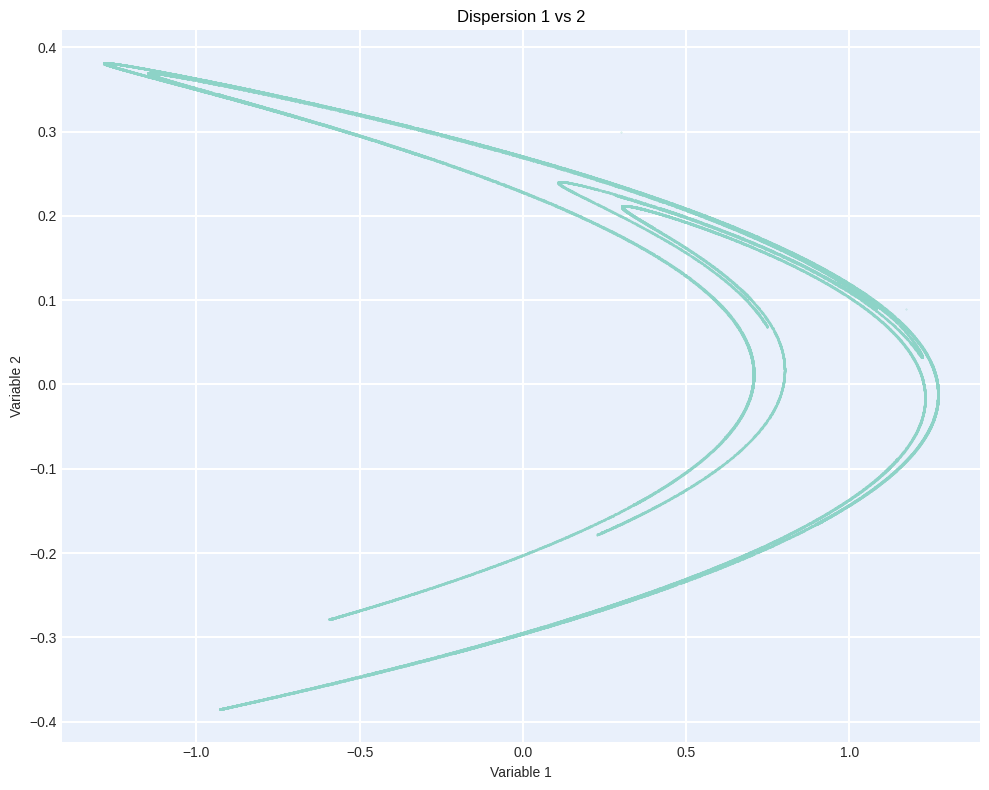

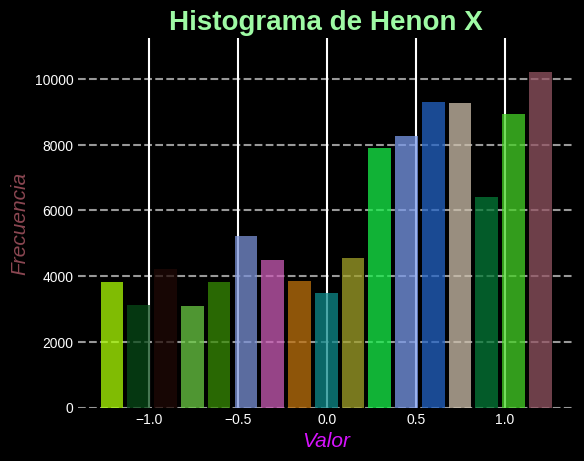

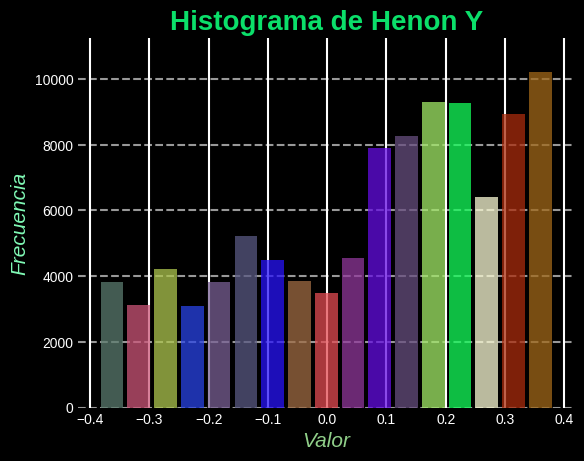

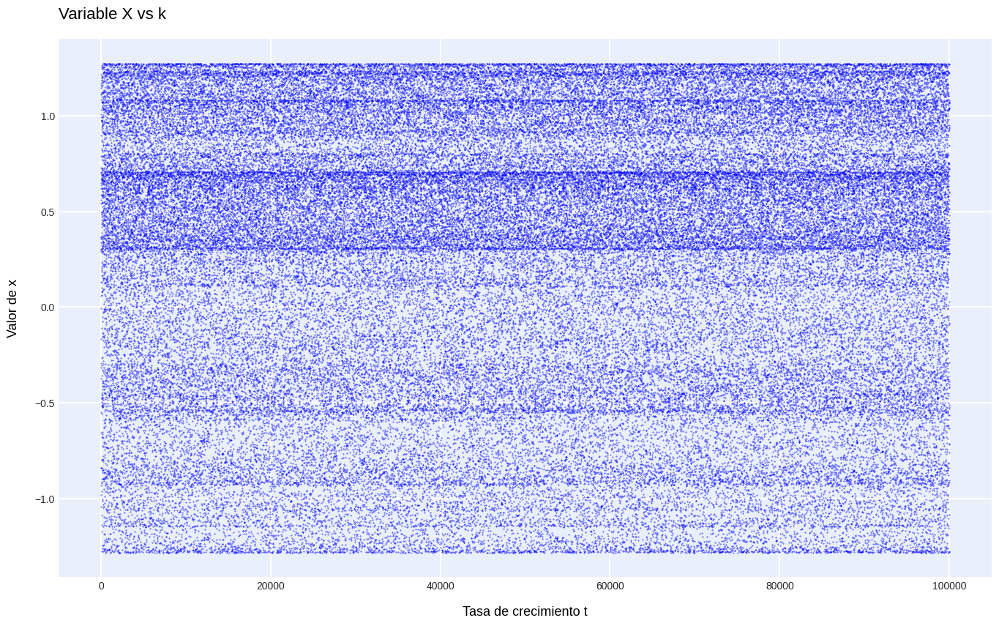

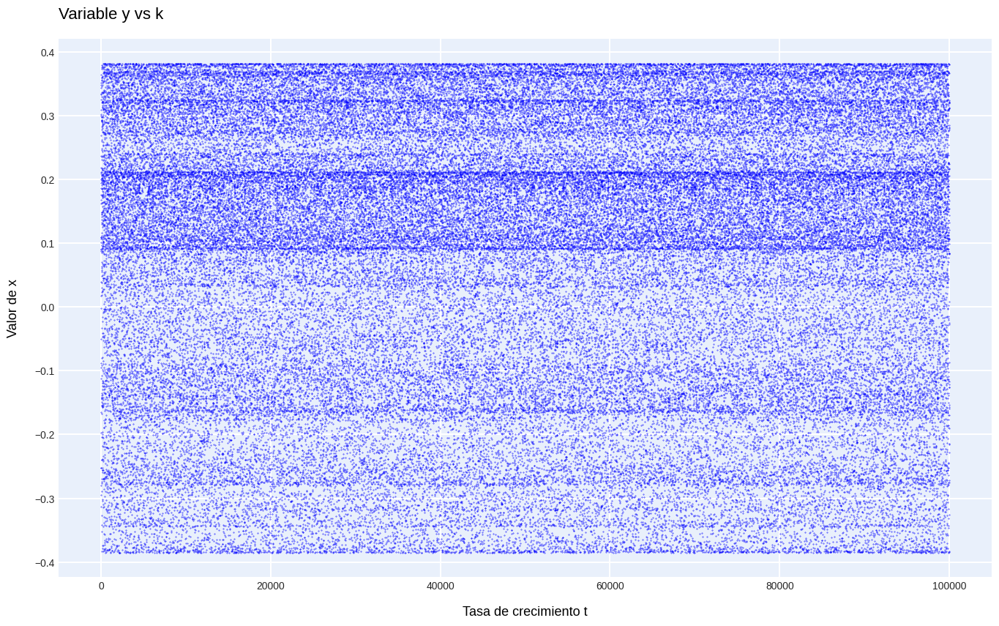

In [80]:
henon = DistribucionProbabilidad(valores_x, valores_y)
henon.mostrar_metricas()
plotear_hist(valores_x, "Histograma de Henon X", "Valor", "Frecuencia", "sturges")
plotear_hist(valores_y, "Histograma de Henon Y", "Valor", "Frecuencia", "sturges")
graficar(valores_x, valores_k, width=10, height=7 ,titulo="Variable X vs k")
graficar(valores_y, valores_k, width=10, height=7 ,titulo="Variable y vs k")

## Análisis de Métricas Estadísticas para el Modelo del Mapa de Henon

#### Variable X
- **Media (0.2569)** y **Mediana (0.4109)**: Estos valores indican que, aunque la media está más cerca de cero, la mediana más alta sugiere una distribución con una cola hacia valores mayores. Esto es típico en sistemas caóticos donde la distribución no es simétrica.

- **Rango (2.5576)**: Un rango amplio muestra que la variable X explora un espectro extenso de valores, lo cual es esperado en dinámicas caóticas como las del mapa de Henon.

- **Desviación Estándar (0.7209)** y **Varianza (0.5197)**: Estas métricas altas reflejan la considerable dispersión de los datos, indicativa de la alta variabilidad inherente a este sistema.

- **Entropía (11.5129)**: Una entropía muy alta sugiere una distribución compleja y diversa de los valores, característica de los comportamientos caóticos.

#### Variable Y
- **Media (0.0771)** y **Mediana (0.1233)**: Similar a la variable X, los valores muestran una distribución con ligera asimetría, aunque la diferencia entre la media y la mediana es menor.

- **Desviación Estándar (0.2163)**: Menor en comparación con la variable X, indicando menos variabilidad en esta variable.

### Análisis de Correlación y Gráfica de Dispersión

- **Matriz de Correlación**: Un coeficiente de -0.315 indica una correlación negativa moderada entre las variables. Esto sugiere que a medida que una variable aumenta, la otra tiende a disminuir, lo cual es coherente con el comportamiento esperado del mapa de Henon donde las variables están interconectadas en un sistema dinámico complejo.

### Conclusión

Las métricas estadísticas junto con la matriz de correlación y la gráfica de dispersión revelan un sistema con alta variabilidad y dinámicas complejas interdependientes. La alta entropía y el amplio rango de ambas variables subrayan la rica dinámica caótica del mapa de Henon. Estos resultados son cruciales para entender cómo pequeñas variaciones en las condiciones iniciales pueden resultar en cambios significativos en el comportamiento del sistema, un rasgo definitorio del caos.



# Atractor de Rossler

In [81]:
valores_x = leer_col_csv("datosRossler.csv", "Valores x")
valores_y = leer_col_csv("datosRossler.csv", "Valores y")
valores_z = leer_col_csv("datosRossler.csv", "Valores z")
valores_k = range(1, len(valores_x)+1)
graficar_3d(valores_x, valores_y, valores_z, titulo="Atractor de Rossler")

--- Métricas para Variable 1 ---
Media: 0.18485470681822816
Mediana: -0.22063136624253193
Moda: -9.28112168747234
Media Geométrica: nan
Rango: 21.07306785563107
Desviación Estándar: 4.998003092482866
Varianza: 24.980034912468287
Asimetría: 0.20554979315632138
Curtosis: -0.5972925304986041
Entropia: 11.512925464970223
Coeficiente de Variación: 27.03746730883902

--- Métricas para Variable 2 ---
Media: -0.908295039420532
Mediana: -0.8376306330690166
Moda: -11.090572417946863
Media Geométrica: nan
Rango: 19.023502319928667
Desviación Estándar: 4.742096688026963
Varianza: 22.48748099859629
Asimetría: -0.17152034988291723
Curtosis: -0.6646172866952118
Entropia: 11.512925464970223
Coeficiente de Variación: -5.220877008259666

--- Métricas para Variable 3 ---
Media: 0.9022493082024416
Mediana: 0.04085462120151002
Moda: 0.013365904330161932
Media Geométrica: 0.07601411137144386
Rango: 26.4706830221461
Desviación Estándar: 3.4708531990836273
Varianza: 12.046821929589049
Asimetría: 5.21385406970

/home/rodrigo/.local/lib/python3.10/site-packages/scipy/stats/_stats_py.py:197: RuntimeWarning:

invalid value encountered in log



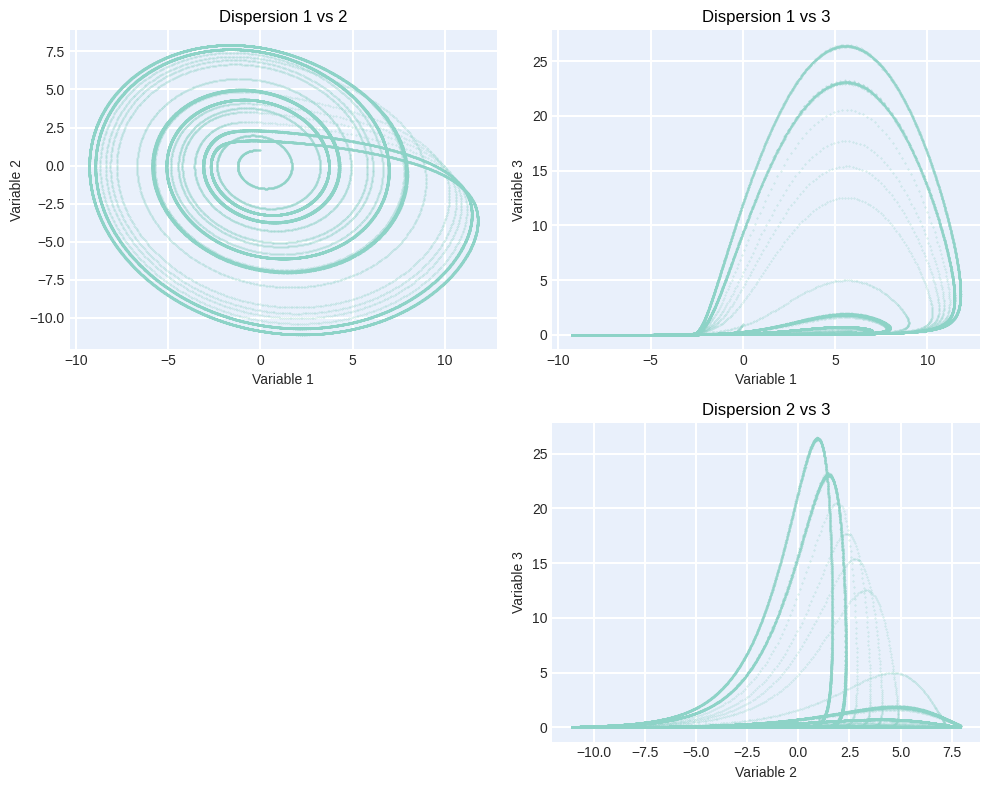

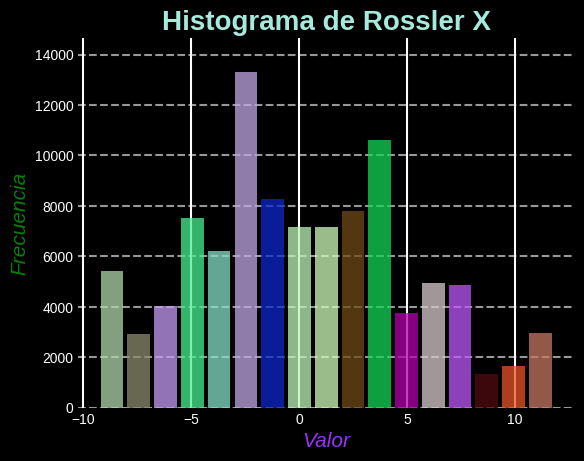

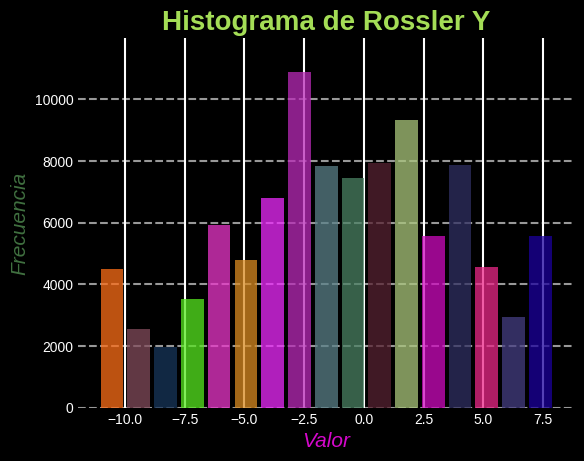

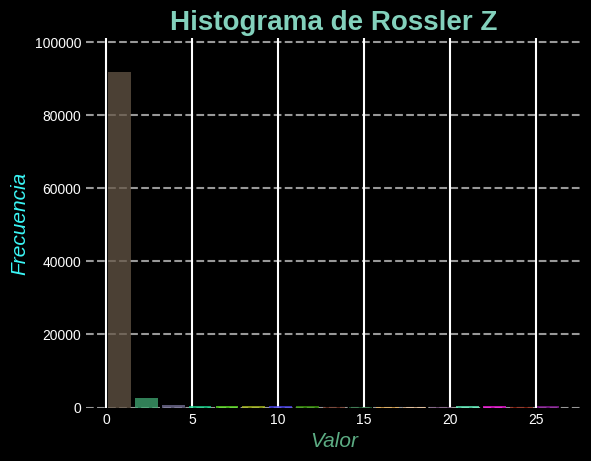

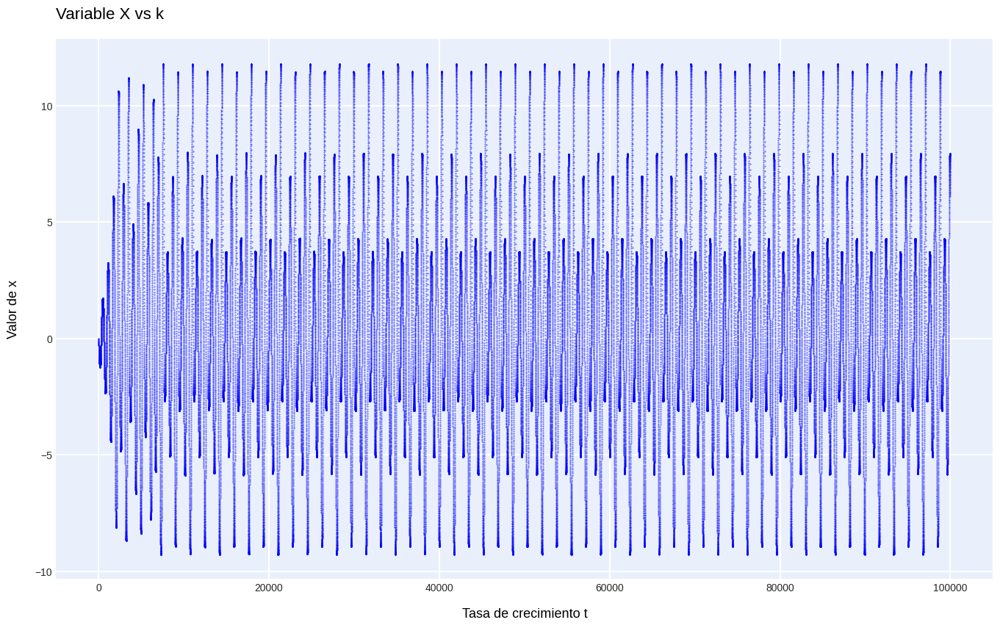

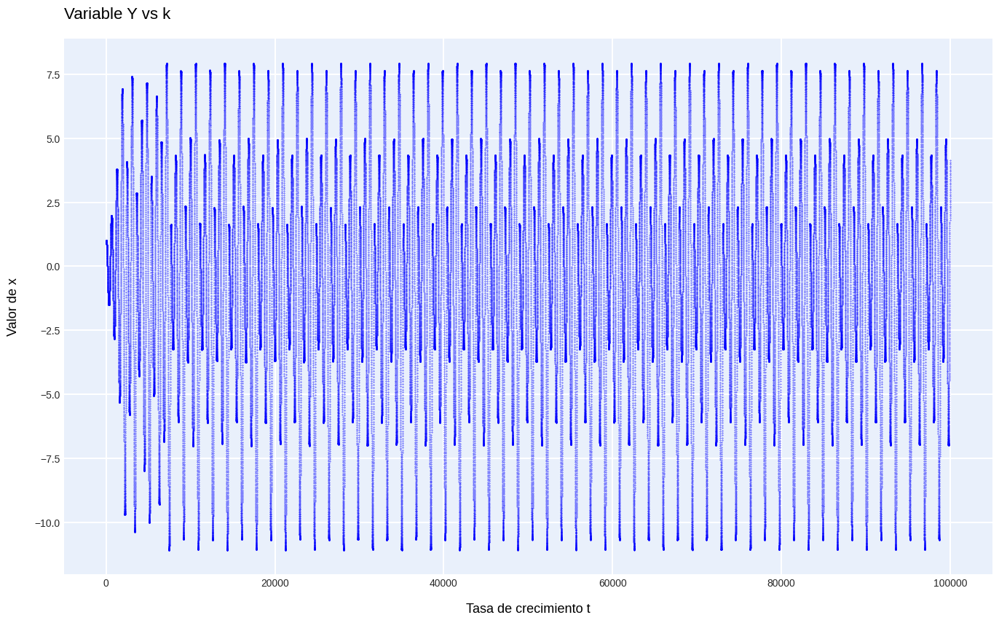

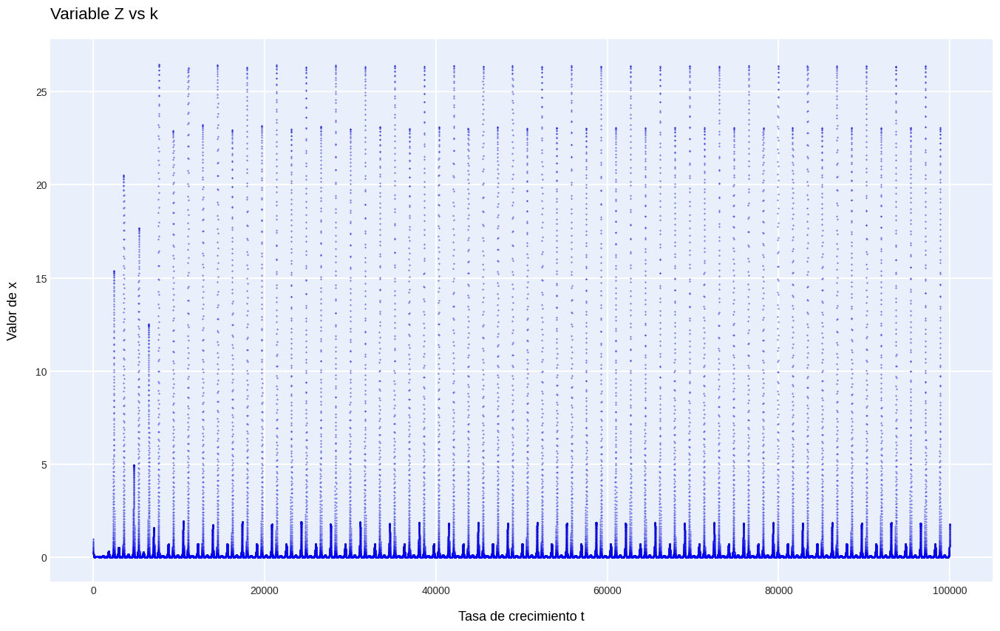

In [82]:
rossler = DistribucionProbabilidad(valores_x, valores_y, valores_z)
rossler.mostrar_metricas()
plotear_hist(valores_x, "Histograma de Rossler X", "Valor", "Frecuencia", "sturges")
plotear_hist(valores_y, "Histograma de Rossler Y", "Valor", "Frecuencia", "sturges")
plotear_hist(valores_z, "Histograma de Rossler Z", "Valor", "Frecuencia", "sturges")
graficar(valores_x, valores_k, width=10, height=7 ,titulo="Variable X vs k")
graficar(valores_y, valores_k, width=10, height=7 ,titulo="Variable Y vs k")
graficar(valores_z, valores_k, width=10, height=7 ,titulo="Variable Z vs k")

## Análisis de Métricas Estadísticas para el Modelo del Atractor de Rossler

### Análisis de Métricas Estadísticas

- **Rango**: Los rangos amplios en todas las variables (Variable X: 21.07, Variable Y: 19.02, Variable Z: 26.47) indican que cada variable explora un amplio espectro de valores. Esto es característico de sistemas caóticos donde los estados pueden cambiar dramáticamente a lo largo del tiempo.

- **Desviación Estándar y Varianza**: Altas en todas las variables (por ejemplo, Variable X: Desviación Estándar de 5.00, Varianza de 25.02), reflejan la considerable dispersión y la alta variabilidad de los datos. Esto subraya la naturaleza impredecible y sensible a las condiciones iniciales del sistema.

- **Curtosis y Asimetría**: La curtosis elevada en la Variable Z (27.85) junto con una asimetría significativa (5.21) indica una distribución con colas pesadas y un pico agudo. Esto sugiere la presencia de comportamientos extremos y transiciones abruptas típicas en dinámicas caóticas.

- **Entropía (11.9184 para todas las variables)**: Una entropía consistentemente alta a través de las variables muestra una gran diversidad en los estados del sistema, lo cual es un indicador de complejidad y caos.

### Análisis de Correlación y Gráfica de Dispersión

- **Matriz de Correlación**: La correlación entre las variables muestra valores bajos y mixtos (por ejemplo, 0.274 entre la Variable 1 y la Variable 3), indicando que no hay una fuerte dependencia lineal entre ellas. Esto es esperado en sistemas caóticos donde las relaciones no son simples ni directamente proporcionales.

### Conclusión

Las métricas estadísticas y las visualizaciones del atractor de Rossler resaltan un sistema con extrema variabilidad y complejidad. La amplia gama de valores explorados por las variables, junto con altas entropías y patrones de dispersión característicos, confirman la naturaleza caótica del atractor. Este análisis proporciona una comprensión profunda de cómo las variables interactúan y evolucionan en el tiempo dentro de este sistema dinámico.



### Atractor de Lorentz

In [83]:
valores_x = leer_col_csv("datosLorentz.csv", "Valores x")
valores_y = leer_col_csv("datosLorentz.csv", "Valores y")
valores_z = leer_col_csv("datosLorentz.csv", "Valores z")
valores_k = range(1, len(valores_x)+1)
graficar_3d(valores_x, valores_y, valores_z, titulo="Atractor de Lorentz")

--- Métricas para Variable 1 ---
Media: -0.8837743511144559
Mediana: -1.2706424157711937
Moda: -18.81364430507488
Media Geométrica: nan
Rango: 38.56871649435135
Desviación Estándar: 7.964705996176799
Varianza: 63.436541605534664
Asimetría: 0.2116758898459656
Curtosis: -0.7767563835465703
Entropia: 11.512925464970223
Coeficiente de Variación: -9.01214884334803

--- Métricas para Variable 2 ---
Media: -0.8926042312278303
Mediana: -1.1269238369230985
Moda: -25.60801161362229
Media Geométrica: nan
Rango: 53.02582318365201
Desviación Estándar: 8.981911993104438
Varianza: 80.67474305187335
Asimetría: 0.21541672236583292
Curtosis: -0.2165588403431289
Entropia: 11.512925464970223
Coeficiente de Variación: -10.06259177233485

--- Métricas para Variable 3 ---
Media: 23.943247724589817
Mediana: 23.718936504537208
Moda: 0.8609231341947348
Media Geométrica: 22.237786636601825
Rango: 47.54539290506558
Desviación Estándar: 8.350685729826283
Varianza: 69.73395215832431
Asimetría: 0.07697925163258434
C

/home/rodrigo/.local/lib/python3.10/site-packages/scipy/stats/_stats_py.py:197: RuntimeWarning:

invalid value encountered in log



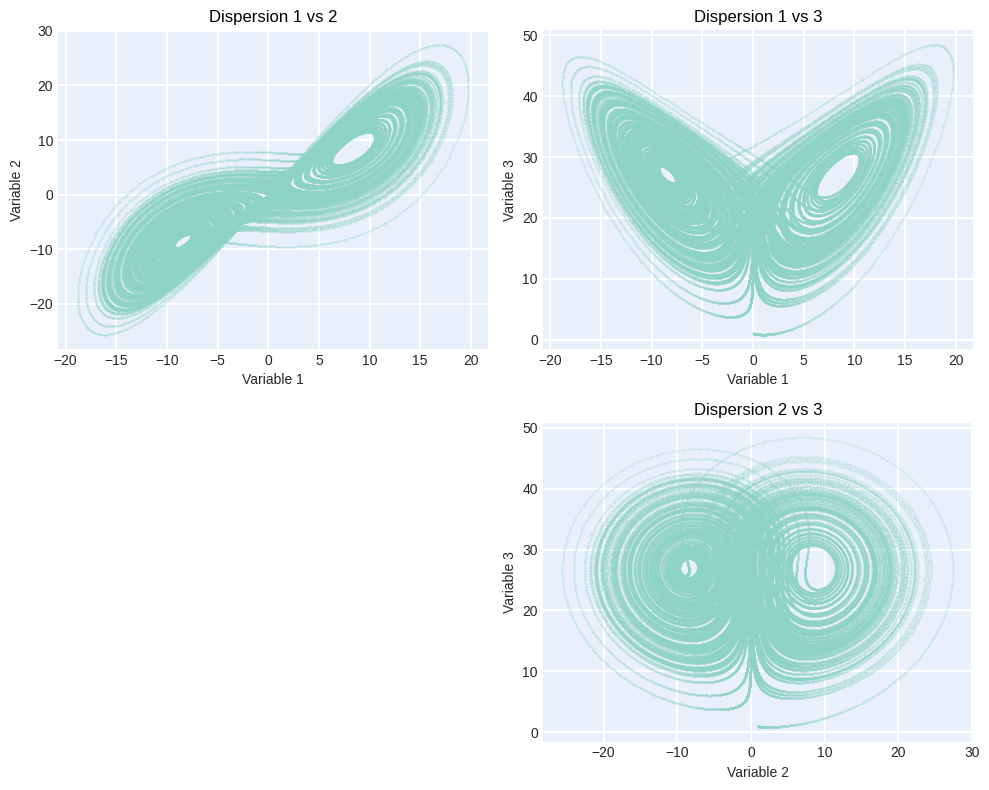

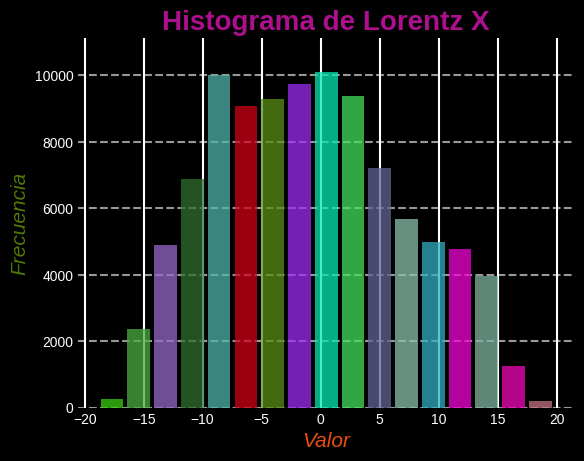

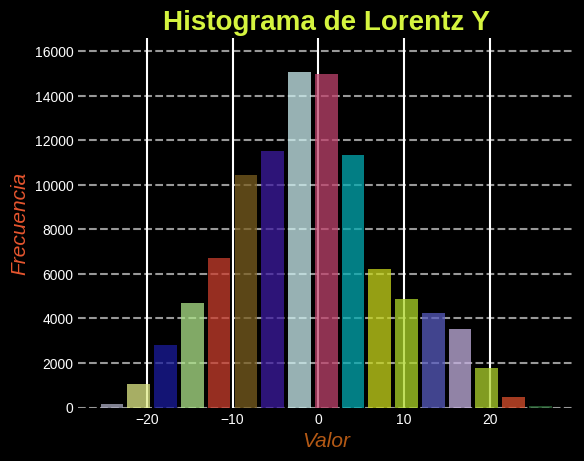

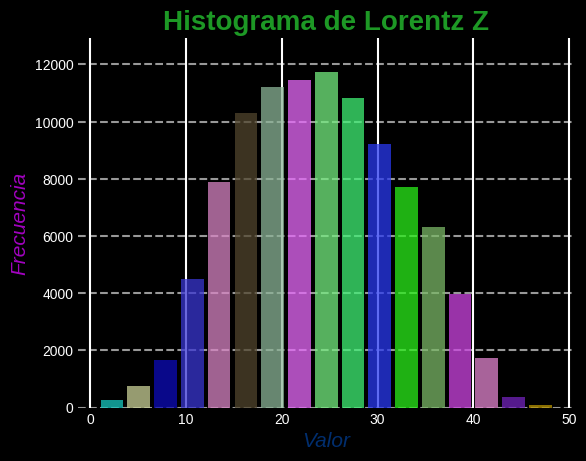

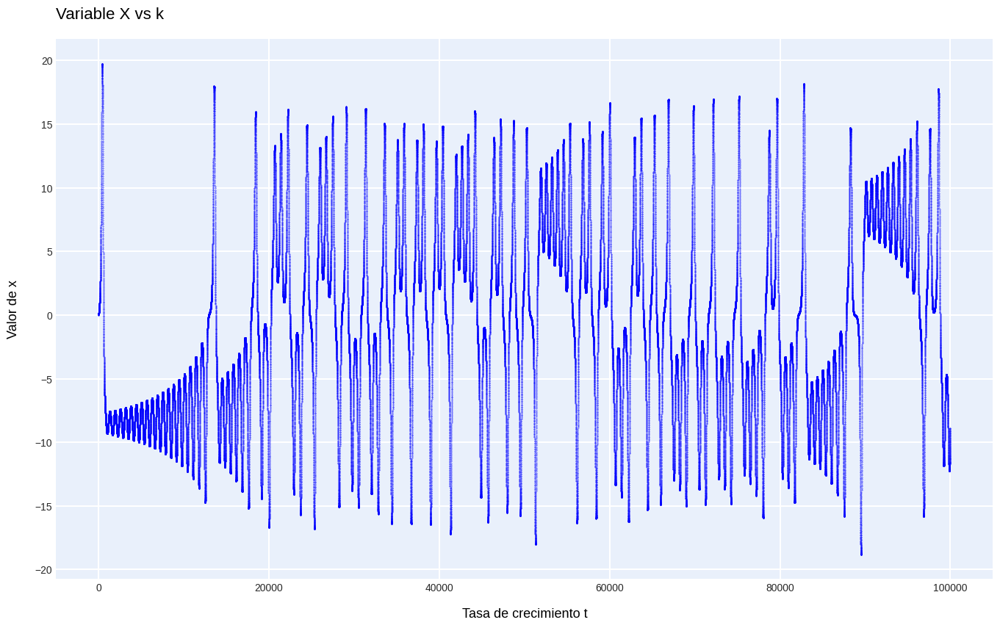

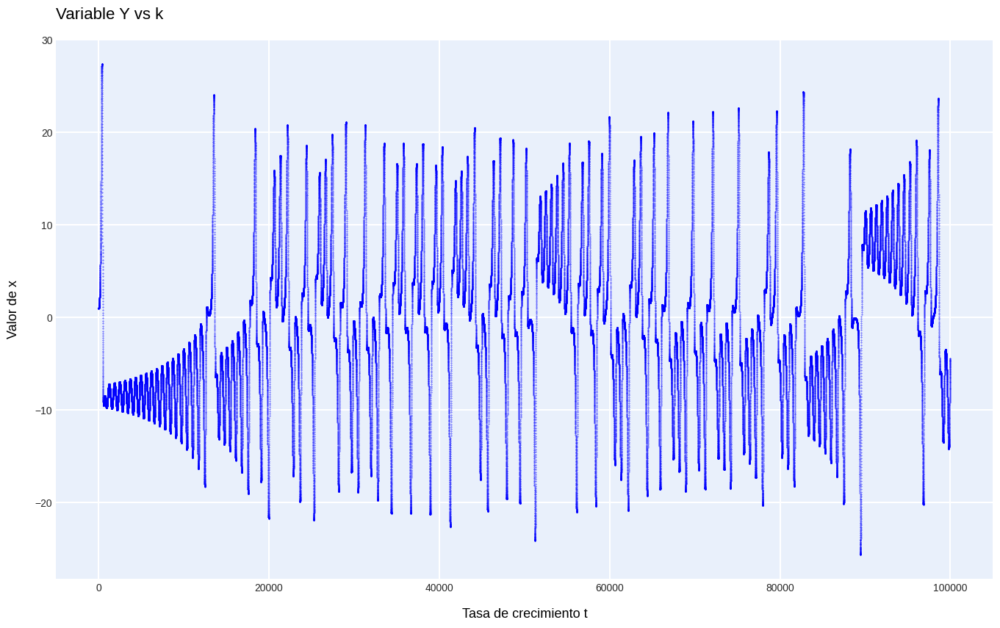

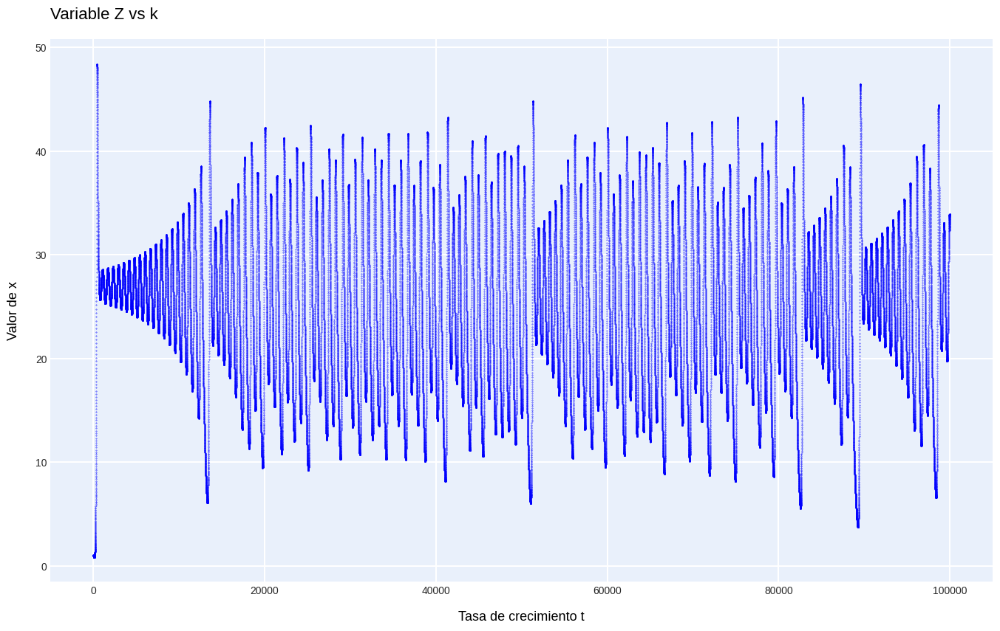

In [84]:
lorentz = DistribucionProbabilidad(valores_x, valores_y, valores_z)
lorentz.mostrar_metricas()
plotear_hist(valores_x, "Histograma de Lorentz X", "Valor", "Frecuencia", "sturges")
plotear_hist(valores_y, "Histograma de Lorentz Y", "Valor", "Frecuencia", "sturges")
plotear_hist(valores_z, "Histograma de Lorentz Z", "Valor", "Frecuencia", "sturges")
graficar(valores_x, valores_k, width=10, height=7 ,titulo="Variable X vs k")
graficar(valores_y, valores_k, width=10, height=7 ,titulo="Variable Y vs k")
graficar(valores_z, valores_k, width=10, height=7 ,titulo="Variable Z vs k")

## Análisis de Métricas Estadísticas para el Modelo del Atractor de Lorenz

### Análisis de Métricas Estadísticas

- **Rango**: Los rangos muy amplios para todas las variables (Variable X: 38.57, Variable Y: 53.03, Variable Z: 47.55) indican que cada variable explora extensivamente su espacio de estado. Esto subraya la gran variabilidad y la capacidad del sistema para transitar por estados muy distintos, lo cual es característico de la dinámica caótica.

- **Desviación Estándar y Varianza**: Altas en todas las variables (Variable X: Desviación Estándar de 7.98, Varianza de 63.72; Variable Y: Desviación Estándar de 9.03, Varianza de 81.57), reflejan una considerable dispersión de los datos y subrayan la alta variabilidad y la naturaleza impredecible del sistema.

- **Curtosis y Asimetría**: La curtosis ligeramente negativa en todas las variables indica una distribución más plana que la normal, lo que sugiere un perfil de distribución con colas pesadas. La asimetría cercana a cero sugiere una simetría relativa en la distribución de los valores alrededor de la media.

### Análisis de Correlación y Gráfica de Dispersión

- **Matriz de Correlación**: La correlación notablemente alta entre las variables X y Y (0.883) sugiere una fuerte relación lineal entre estas dimensiones del sistema, lo cual es interesante dado que el atractor de Lorenz tiende a mostrar una estructura de alas de mariposa simétrica que podría explicar esta correlación. Las correlaciones cercanas a cero con la Variable Z indican que esta dimensión opera más independientemente, lo cual es característico de sistemas con dinámicas multidimensionales complejas.

- **Gráfica de Dispersión**: Las visualizaciones muestran claros patrones de atractor extraño con estructuras en forma de mariposa y anillos concéntricos que son típicos del atractor de Lorenz. Estos patrones son indicativos de la dinámica no lineal y recurrente del sistema y proporcionan una confirmación visual de la naturaleza caótica y compleja del atractor.

### Conclusión

Las métricas y las visualizaciones para el atractor de Lorenz ilustran un sistema con una variabilidad extremadamente alta y relaciones complejas entre sus variables. Los amplios rangos y las altas desviaciones estándar, junto con las visualizaciones que muestran patrones distintivos de atractores extraños, confirman la naturaleza dinámica y caótica del sistema. Este análisis destaca cómo el atractor de Lorenz continúa siendo un ejemplo fascinante de caos determinista en sistemas dinámicos.

